In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from rich.progress import track
from scipy.interpolate import griddata
from mpl_toolkits.axes_grid1 import make_axes_locatable

from astropy.io import fits
from astropy.table import Table
from astropy.wcs import WCS
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize


In [ ]:
cosmos_xid24 = Table.read('/data/observation_data/Master_Post_Catalogue_MIPS_PACS_SPIRE_SCUBA.fits')

cols_to_drop = [col for col in cosmos_xid24.colnames if ('post' in col.lower()) or ('tile') in col.lower()]
if cols_to_drop:
    cosmos_xid24.remove_columns(cols_to_drop)

cosmos_xid24_df = cosmos_xid24.to_pandas()

In [ ]:
bands = ['24', '250', '350', '500', '450']

base_path_datamaps = r"/data/observation_data"
paths_cosmos_datamaps = ["mips_24_GO3_sci_10.fits", "COSMOS-Nest_image_250_SMAP_v6.0.fits", "COSMOS-Nest_image_350_SMAP_v6.0.fits", "COSMOS-Nest_image_500_SMAP_v6.0.fits", "SCS_450.fits"]
hdu_index_list = [0, 1, 1, 1, 0]
corr_factor_l = [0.865e-3*1.369, 1, 1, 1, 1e-3]
max_hdu_index_l = [-1, -1, -1, -1, 2]
bkg_l = [-1.514e-5, -2.473e-3, -3.425e-3, -3.960e-3, 0]

In [4]:
def process_hdul(base_path_datamaps, path, hdu_index, corr_factor, bkg_image, suffix, max_hdu_idx=-1):
    with fits.open(os.path.join(base_path_datamaps, path)) as hdul:
        print(hdul)
        for idx, hdu in enumerate(hdul):
            if max_hdu_idx != -1 and idx >= max_hdu_idx:
                break

            # First the correction, i.e. side-lobes and unit conversion
            if hdu.data is not None:
                hdu.data *= corr_factor

            # Then the background subtraction
            if idx == hdu_index and bkg_image is not None:
                hdu.data -= bkg_image

        # Save the modified HDU to a new FITS file
        ## get file_name without extension
        file_name = os.path.splitext(os.path.basename(path))[0]
        hdul.writeto(os.path.join(base_path_datamaps, file_name + suffix), overwrite=True)

def load_fits_image(path, hdu_index=0):
    with fits.open(path) as hdul:
        image_data = hdul[hdu_index].data
        header = hdul[hdu_index].header
        wcs = WCS(header)
    return image_data, wcs, header

# XID+ Interpolated background methodology

In [5]:
def get_datamap_bkg(xid_df, band, image_data, wcs):
    """
    Efficiently calculate the background image for a given band using the XID+ background values.
    """

    # Extract source positions and background
    ra = xid_df['RA'].values.astype(np.float32)
    dec = xid_df['Dec'].values.astype(np.float32)
    bkg = (xid_df[f'Bkg_{band}'].values * 1e-3).astype(np.float32)  # Convert from mJy to Jy

    # Filter valid values
    valid_mask = ~np.isnan(bkg)
    ra_valid = ra[valid_mask]
    dec_valid = dec[valid_mask]
    bkg_valid = bkg[valid_mask]

    # Image shape and output array
    ny, nx = image_data.shape
    bkg_image = np.full((ny, nx), np.nan, dtype=np.float32)

    chunk_size = 1000

    for i in track(range(0, ny, chunk_size), total=(ny + chunk_size - 1) // chunk_size, description="Processing rows..."):
        i_end = min(i + chunk_size, ny)
        for j in range(0, nx, chunk_size):
            j_end = min(j + chunk_size, nx)

            # Convert pixel to world coordinates for the current chunk only
            y_chunk, x_chunk = np.mgrid[i:i_end, j:j_end]
            ra_chunk, dec_chunk = wcs.all_pix2world(x_chunk, y_chunk, 0)

            # Interpolate for this chunk
            bkg_chunk = griddata(
                (ra_valid, dec_valid),
                bkg_valid,
                (ra_chunk, dec_chunk),
                method='linear'
            )

            # Fill result into output array
            bkg_image[i:i_end, j:j_end] = bkg_chunk

    # Fill out-of-range NaNs with median background
    bkg_median = np.nanmedian(bkg_valid)
    print(f"Median background for band {band}: {bkg_median:.6f} Jy")
    bkg_image[np.isnan(bkg_image)] = bkg_median

    return bkg_image

Output()

Processing band: 24


Median background for band 24: -0.000015 Jy


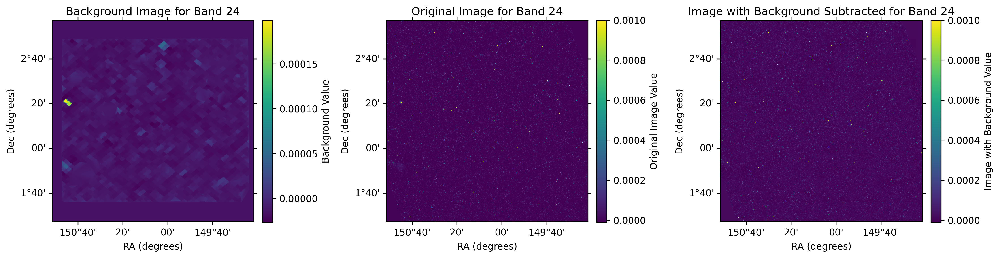

Output()

Processing band: 250


Set MJD-END to 55733.595211 from DATE-END'. [astropy.wcs.wcs]


Median background for band 250: -0.002473 Jy
[<astropy.io.fits.hdu.image.PrimaryHDU object at 0x796b2db5fdc0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2db9aef0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2db9b190>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2db9b3d0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2dd29a80>]


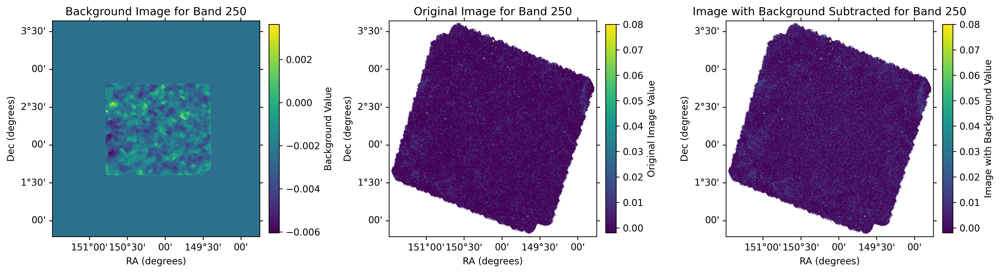

Output()

Processing band: 350


Set MJD-END to 55733.595211 from DATE-END'. [astropy.wcs.wcs]


Median background for band 350: -0.003425 Jy
[<astropy.io.fits.hdu.image.PrimaryHDU object at 0x796b2ad8de10>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2ada8700>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2ada89a0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2ada8be0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2ada8610>]


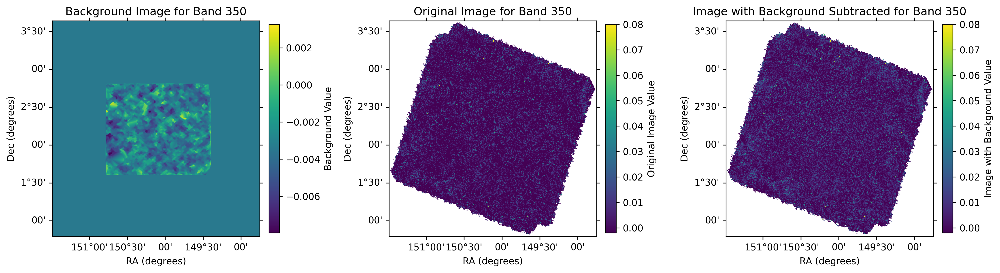

Output()

Processing band: 500


Set MJD-END to 55733.595211 from DATE-END'. [astropy.wcs.wcs]


Median background for band 500: -0.003960 Jy
[<astropy.io.fits.hdu.image.PrimaryHDU object at 0x796b2ada9780>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b26983a60>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b269823e0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b26964190>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b269652a0>]


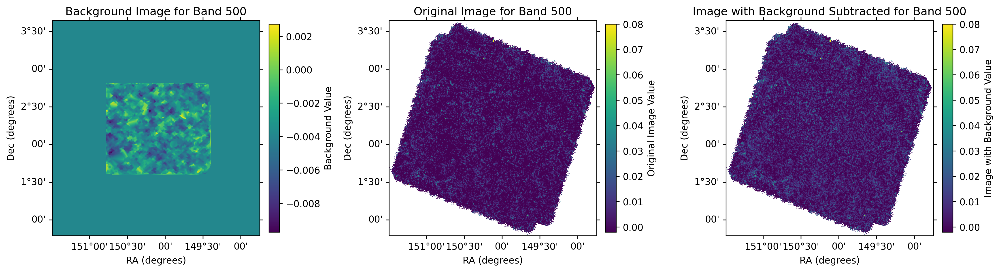

Processing band: 450


Set OBSGEO-B to    19.822853 from OBSGEO-[XYZ].
Set OBSGEO-H to     4120.022 from OBSGEO-[XYZ]'. [astropy.wcs.wcs]


In [6]:
for band, path, hdu_index, corr_factor, max_hdu_index in zip(bands, paths_cosmos_datamaps, hdu_index_list, corr_factor_l, max_hdu_index_l):
    print(f"Processing band: {band}")

    # Load the COSMOS data map
    image_data, wcs, header = load_fits_image(os.path.join(base_path_datamaps, path), hdu_index)

    # We do not add background for the 450 micron band
    if band != '450':
        # Get the background image using the XID+ background values
        bkg_image = get_datamap_bkg(cosmos_xid24_df, band, image_data, wcs)
        suffix = f'_interp_bkg_subtracted.fits'

    else:
        # For the 450 micron band, we do not subtract the background
        bkg_image = None
        suffix = f'_corr.fits'
    
    process_hdul(base_path_datamaps, path, hdu_index, corr_factor, bkg_image, max_hdu_idx=max_hdu_index, suffix=suffix)

    # Plotting the datamaps
    if band != '450':
        image_data *= corr_factor  # Apply the correction factor to the image data
        # Subtract the background from the image data
        image_plus_bkg = image_data - bkg_image

        # Plot the three images: background grid, original image, and image with background added
        if band == '24':
            vmin, vmax = -10e-6, 1e-3
        else:
            vmin, vmax = -2e-3, 80e-3

        # Create high resolution figure and set x-axis to degrees for each WCSAxes
        fig = plt.figure(figsize=(15, 5), dpi=300)
        ax0 = fig.add_subplot(1, 3, 1, projection=wcs)
        ax1 = fig.add_subplot(1, 3, 2, projection=wcs)
        ax2 = fig.add_subplot(1, 3, 3, projection=wcs)
        axes = [ax0, ax1, ax2]

        for ax in axes:
            ax.coords[0].set_format_unit('deg')
            ax.coords[1].set_format_unit('deg')

        # Background image plot (from the XID+ background values)
        im0 = axes[0].imshow(bkg_image, origin='lower', cmap='viridis')
        axes[0].set_title(f'Background Image for Band {band}')
        axes[0].set_xlabel('RA (degrees)')
        axes[0].set_ylabel('Dec (degrees)')
        cbar0 = plt.colorbar(im0, ax=axes[0], orientation='vertical', fraction=0.046, pad=0.04)
        cbar0.set_label('Background Value')

        # Original image plot
        im1 = axes[1].imshow(image_data, origin='lower', cmap='viridis', vmin=vmin, vmax=vmax)
        axes[1].set_title(f'Original Image for Band {band}')
        axes[1].set_xlabel('RA (degrees)')
        axes[1].set_ylabel('Dec (degrees)')
        cbar1 = plt.colorbar(im1, ax=axes[1], orientation='vertical', fraction=0.046, pad=0.04)
        cbar1.set_label('Original Image Value')

        # Image with background subtracted plot
        im2 = axes[2].imshow(image_plus_bkg, origin='lower', cmap='viridis', vmin=vmin, vmax=vmax)
        axes[2].set_title(f'Image with Background Subtracted for Band {band}')
        axes[2].set_xlabel('RA (degrees)')
        axes[2].set_ylabel('Dec (degrees)')
        cbar2 = plt.colorbar(im2, ax=axes[2], orientation='vertical', fraction=0.046, pad=0.04)
        cbar2.set_label('Image with Background Value')

        plt.tight_layout()
        plt.show()

# Constant background subtraction methodology

Processing band: 24


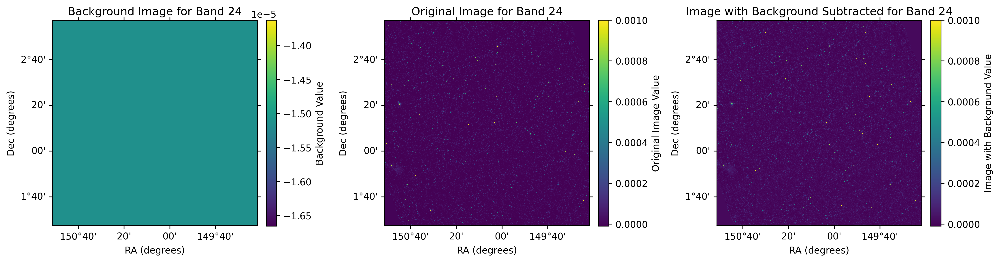

Processing band: 250
[<astropy.io.fits.hdu.image.PrimaryHDU object at 0x796b290e78b0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2dcfff10>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2dcfcb50>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2ad53a90>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2ad53fa0>]


Set MJD-END to 55733.595211 from DATE-END'. [astropy.wcs.wcs]


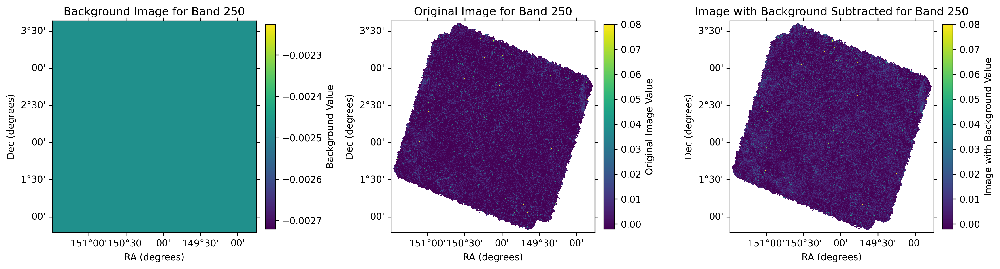

Processing band: 350
[<astropy.io.fits.hdu.image.PrimaryHDU object at 0x796b2dcfd7e0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b28e70e20>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b28e715a0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b28e703a0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b28e71990>]


Set MJD-END to 55733.595211 from DATE-END'. [astropy.wcs.wcs]


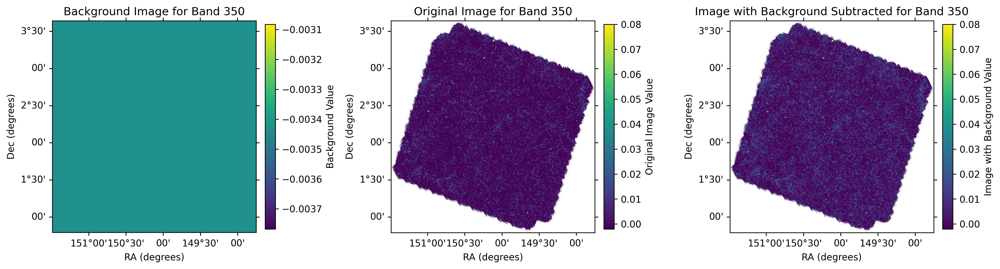

Processing band: 500
[<astropy.io.fits.hdu.image.PrimaryHDU object at 0x796ede82f400>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2ad7a380>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2ad78fa0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2ad7a650>, <astropy.io.fits.hdu.image.ImageHDU object at 0x796b2ddf1870>]


Set MJD-END to 55733.595211 from DATE-END'. [astropy.wcs.wcs]


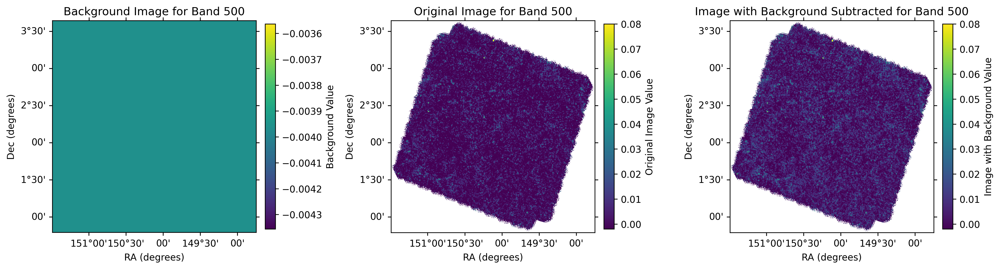

Processing band: 450


Set OBSGEO-B to    19.822853 from OBSGEO-[XYZ].
Set OBSGEO-H to     4120.022 from OBSGEO-[XYZ]'. [astropy.wcs.wcs]


In [8]:
for band, path, hdu_index, corr_factor, max_hdu_index, bkg in zip(bands, paths_cosmos_datamaps, hdu_index_list, corr_factor_l, max_hdu_index_l, bkg_l):
    print(f"Processing band: {band}")

    # Load the COSMOS data map
    image_data, wcs, header = load_fits_image(os.path.join(base_path_datamaps, path), hdu_index)

    # The background image is the median background as calculated from the XID+ background values
    if band != '450':
        bkg_image = np.full(image_data.shape, bkg, dtype=np.float32)
        suffix = f'_median_bkg_subtracted.fits'

    else:
        # For the 450 micron band, we do not subtract the background
        bkg_image = None
        suffix = f'_corr.fits'
    
    process_hdul(base_path_datamaps, path, hdu_index, corr_factor, bkg_image, max_hdu_idx=max_hdu_index, suffix=suffix)

    # Plotting the datamaps
    if band != '450':
        image_data *= corr_factor  # Apply the correction factor to the image data
        # Subtract the background from the image data
        image_plus_bkg = image_data - bkg_image

        # Plot the three images: background grid, original image, and image with background added
        if band == '24':
            vmin, vmax = -10e-6, 1e-3
        else:
            vmin, vmax = -2e-3, 80e-3

        # Create high resolution figure and set x-axis to degrees for each WCSAxes
        fig = plt.figure(figsize=(15, 5), dpi=300)
        ax0 = fig.add_subplot(1, 3, 1, projection=wcs)
        ax1 = fig.add_subplot(1, 3, 2, projection=wcs)
        ax2 = fig.add_subplot(1, 3, 3, projection=wcs)
        axes = [ax0, ax1, ax2]

        for ax in axes:
            ax.coords[0].set_format_unit('deg')
            ax.coords[1].set_format_unit('deg')

        # Background image plot (from the XID+ background values)
        im0 = axes[0].imshow(bkg_image, origin='lower', cmap='viridis')
        axes[0].set_title(f'Background Image for Band {band}')
        axes[0].set_xlabel('RA (degrees)')
        axes[0].set_ylabel('Dec (degrees)')
        cbar0 = plt.colorbar(im0, ax=axes[0], orientation='vertical', fraction=0.046, pad=0.04)
        cbar0.set_label('Background Value')

        # Original image plot
        im1 = axes[1].imshow(image_data, origin='lower', cmap='viridis', vmin=vmin, vmax=vmax)
        axes[1].set_title(f'Original Image for Band {band}')
        axes[1].set_xlabel('RA (degrees)')
        axes[1].set_ylabel('Dec (degrees)')
        cbar1 = plt.colorbar(im1, ax=axes[1], orientation='vertical', fraction=0.046, pad=0.04)
        cbar1.set_label('Original Image Value')

        # Image with background subtracted plot
        im2 = axes[2].imshow(image_plus_bkg, origin='lower', cmap='viridis', vmin=vmin, vmax=vmax)
        axes[2].set_title(f'Image with Background Subtracted for Band {band}')
        axes[2].set_xlabel('RA (degrees)')
        axes[2].set_ylabel('Dec (degrees)')
        cbar2 = plt.colorbar(im2, ax=axes[2], orientation='vertical', fraction=0.046, pad=0.04)
        cbar2.set_label('Image with Background Value')

        plt.tight_layout()
        plt.show()